# Math 4172 Midterm Project Part 1: Efficiencies of the S&P 500 Companies by Classical DEA
### By: Heajung Nam 214457758

### 1. Introduction

The goal of this project is to calculate and compare the efficiencies of the S&P 500 companies to find the best efficient company for investment purposes.

Variables used in this project are the followings:
Input Varaibles: 
-Accounts Receivables: the payment which the company will receive from its customers who have purchased its goods and services on credit. 
-Long-term Debt: the company's loans and other liabilities that will not become due within one year of the balance sheet date.
-Capital Expenditure: the use of funds or assumption of a liability in order to obtain or upgrade physical assets.
-Cost of Goods Sold: the direct costs attributable to the production of the goods sold in a company.
Overall, companies aims to minimize the input varibles to maximize their returns.

Output Variables: 
-Revenue: the amount of money that a company actually receives during a specific period, including discounts and deductions for returned merchandise.
-Earnings per Share: the ratio of a company's profit that is allocated to each outstanding share of its common stock.
Overall, companies aims to maximize the output varaibles.

### 2. Import and Clean-up the Data File

In [3]:
import numpy as np
import pandas as pd 
%matplotlib inline
import matplotlib.pyplot as plt
import pprint
from pyomo.environ import ConcreteModel, Suffix, Var,Objective, Constraint, NonNegativeReals, maximize, value
from pyomo.opt import SolverFactory

#import the DEA_SP500.xlsx file 
sp = pd.read_excel('DEA_SP500.xlsx')
#set the index as company name 
sp = sp.set_index('Company Name')
#Data Clean-Up
#It was observed that there are data entries with null values.
#Companies such as Target Corp or Amazon.com.inc have null values for certain quarters since they measured the variable only at the certain period. 
#find which companies are with missing data 
#determine whether each row has any null value
anynull1 = sp.isnull().any(axis=1)
#add the boolean values by each company name to determine whether the company has any null value
anynull2 = anynull1.groupby('Company Name').sum()
#find list of company names with at least one row with null value
anynull3 = anynull2.index[anynull2 !=0]
#remove any companies with null values
spNew = sp.drop(anynull3)

### 3. Set Data Frame

In [4]:
#update the data file by extracting columns for 8 variables
spNew2 = spNew[['Receivables - Total', 'Long-Term Debt - Total','Capital Expenditures','Cost of Goods Sold','Revenue - Total','Earnings Per Share (Basic) - Excluding Extraordinary Items']]
#update the data file by calculating the mean values of each variables for each company
spNew2 = spNew2.groupby('Company Name').mean()

### 4. Visualization of Data 

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000222A943D8D0>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x00000222A7DB4DD8>]], dtype=object)

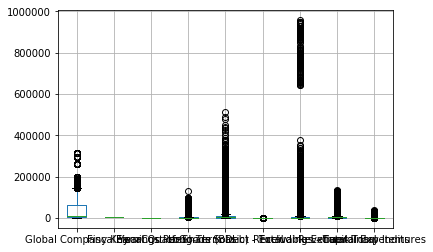

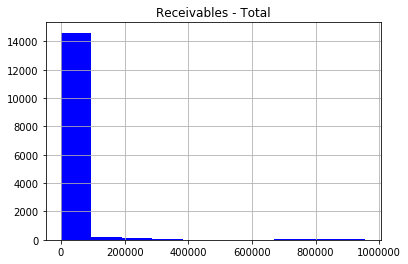

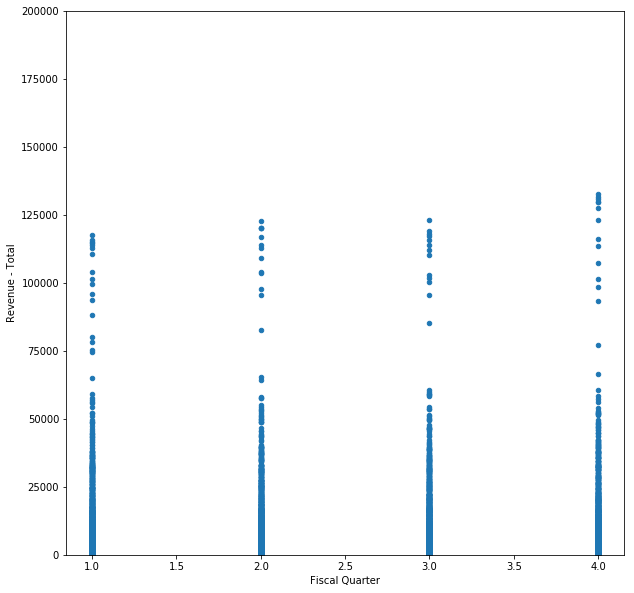

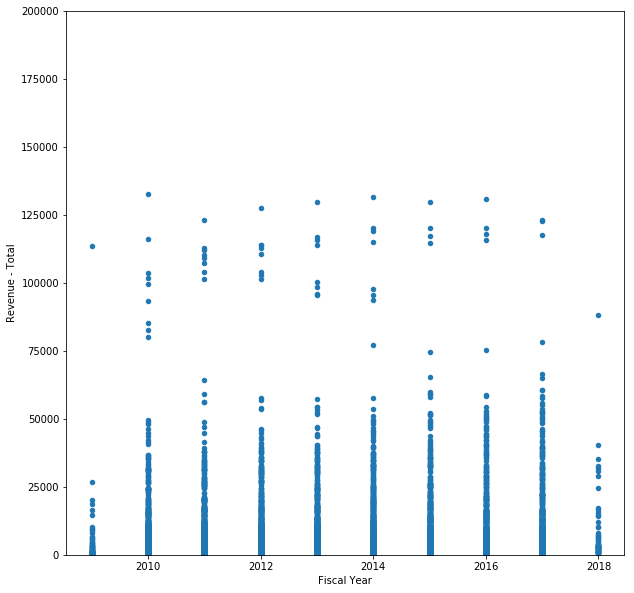

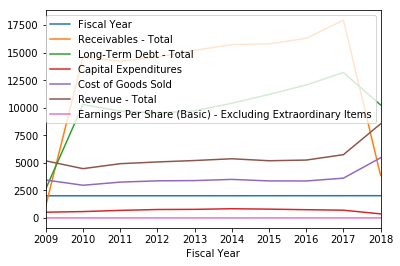

...

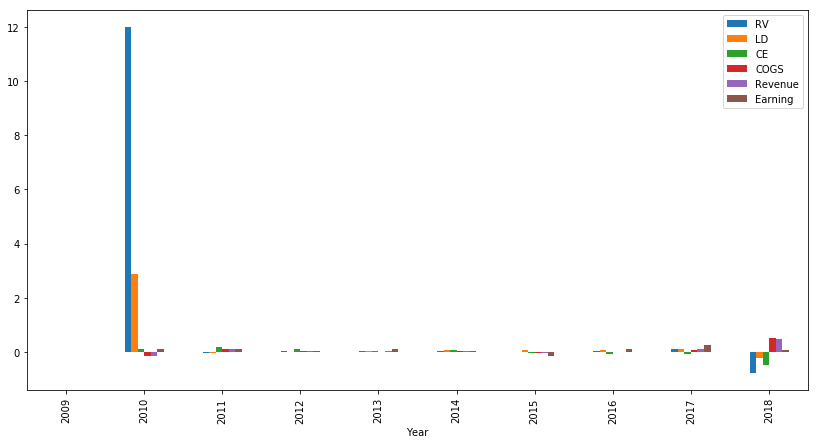

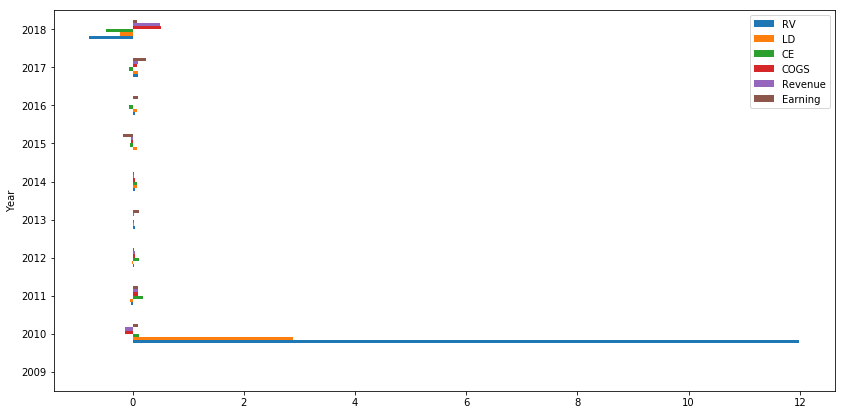

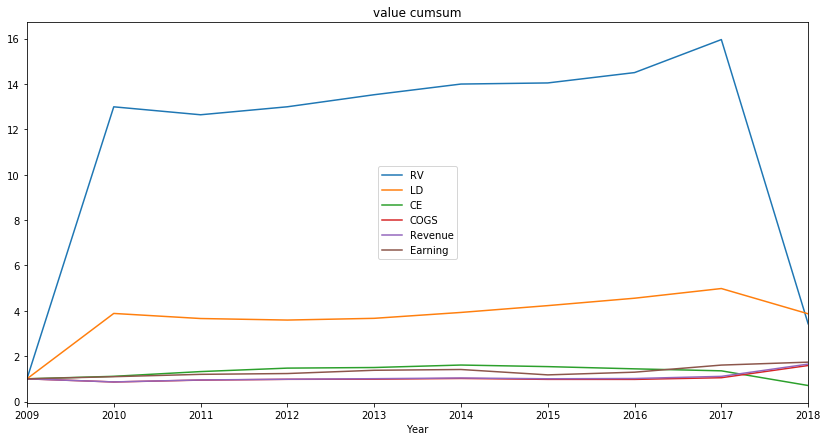

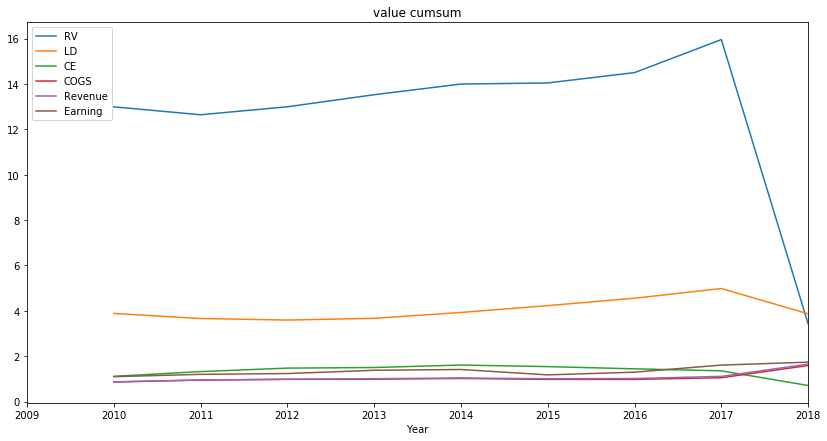

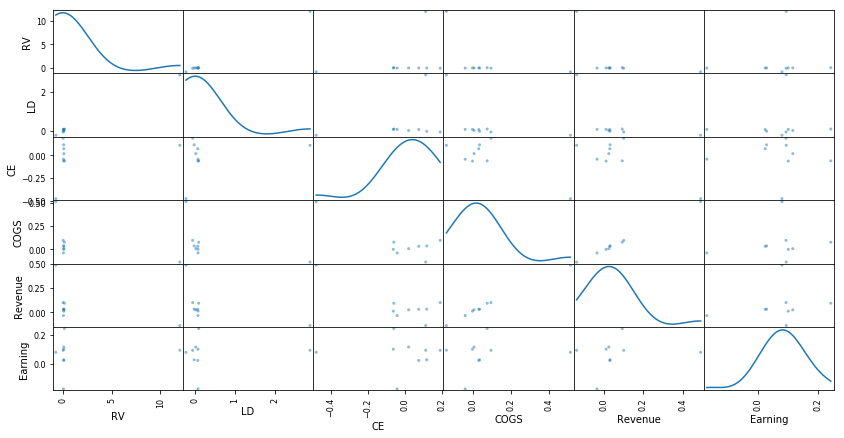

In [5]:
sp.boxplot()

sp.hist(column='Receivables - Total', 
        color='blue')

sp.plot(kind='scatter',
        x='Fiscal Quarter',
        y='Revenue - Total',
        figsize=(10,10),
        ylim=(0,200000))

sp.plot(kind='scatter',
        x='Fiscal Year',
        y='Revenue - Total',
        figsize=(10,10),
        ylim=(0,200000))

#Time series graph of the variables
spNew0 = sp.groupby(['Fiscal Year'])['Fiscal Year','Receivables - Total', 'Long-Term Debt - Total','Capital Expenditures','Cost of Goods Sold','Revenue - Total','Earnings Per Share (Basic) - Excluding Extraordinary Items'].mean()
spNew0.plot()

spNew3 = sp.groupby(['Fiscal Year'])['Fiscal Year','Receivables - Total', 'Long-Term Debt - Total','Capital Expenditures','Cost of Goods Sold','Revenue - Total','Earnings Per Share (Basic) - Excluding Extraordinary Items'].mean()
I = pd.DataFrame(np.array(spNew3.values),columns=['Year','RV','LD','CE','COGS','Revenue','Earning'])
I = I.astype(dtype={'Year':'int64'})
I = I.set_index('Year')
T,N = I.shape            
r = I.pct_change()       #percentage changes
r.describe()             

fsize=(14,7)
I.plot(title='value',figsize=fsize)
r.plot(title='%Change',figsize=fsize)
r.plot.bar(figsize=fsize)
r.plot.barh(figsize=fsize)
(I/I.iloc[0]).plot(title='value cumsum',figsize=fsize)
(r+1).cumprod().plot(title='value cumsum',figsize=fsize)
pd.plotting.scatter_matrix(r,diagonal='kde',figsize=fsize)

### 5. Set Function for Optimization

In [6]:
def DEAs(nUnits, nInputs, nOutputs, Inputs, Outputs,M=1):
	def One(current):
		U = np.arange(nUnits)
		I = np.arange(nInputs)
		O = np.arange(nOutputs)
		model = ConcreteModel()
		model.dual = Suffix(direction=Suffix.IMPORT)
		model.t = Var(O,within=NonNegativeReals) #declare variables with domain
		model.w = Var(I,within=NonNegativeReals)
		model.obj = Objective(expr= sum(model.t[o]*Outputs[current,o] for o in O), sense=maximize) #using expression
		model.con1 = Constraint(U, rule = lambda mo,u : sum(mo.t[o]*Outputs[u,o] for o in O) <= (M if u==current else 1) * sum(mo.w[i]*Inputs[u,i] for i in I) ) #using rules for a set of constraints
		model.con2 = Constraint(expr = sum(model.w[i] * Inputs[current,i] for i in I) <= 1) #using expr for a single constraint
		eps = 0.0001
		model.con3 = Constraint(I, rule = lambda mo, i: model.w[i] >= eps)
		model.con4 = Constraint(O, rule = lambda mo, o: model.t[o] >= eps)        
		return model
	
	opt = SolverFactory("ipopt") #pick up solver conda install -c conda-forge ipopt
	results = []

	from pyomo.opt import SolverStatus, TerminationCondition # for checking solver status
	for current in np.arange(nUnits):
		m = One(current)
		print('\n\n\nCurrent Model Index: %d\n' % current)
		m.pprint()
		r = opt.solve(m)
		print('Solver Status: ',  r.solver.status)
		print('Solver Terminate: ', r.solver.termination_condition)
		#assert (r.solver.status == SolverStatus.ok) and (r.solver.termination_condition == TerminationCondition.optimal) #necessary!!!
		r.write()
		_t = np.zeros(nOutputs)
		_w = np.zeros(nInputs)
		_d = np.zeros(nUnits)
		for o in np.arange(nOutputs):
			_t[o] = value(m.t[o]) #unfortunately, pyomo only let us access variables values one at a time
		for i in np.arange(nInputs):
			_w[i] = value(m.w[i]) #unfortunately, pyomo only let us access variables values one at a time
		for u in np.arange(nUnits):
			_d[u] = m.dual[m.con1[u]]
		results.append({'eff':value(m.obj), 'out':_t, 'in':_w, 'dual':_d})
	return results

### 6. Optimization : Classical DEA

In [7]:
#set data for input and output
ins = spNew2[['Receivables - Total', 'Long-Term Debt - Total','Capital Expenditures','Cost of Goods Sold']]
outs = spNew2[['Revenue - Total','Earnings Per Share (Basic) - Excluding Extraordinary Items']]
#extracting the unique company names
names = ins.index.unique()

#set values for the variables before proceed with the DEAs function
nUnits = len(names)                    #total number of the companies
nInputs = 4                            #number of input variables
nOutputs = 2                           #number of output variables
Inputs = np.array(ins.values)          #transform the values of input as list of arrays
Outputs = np.array(outs.values)        #transform the values of output as list of arrays 

#results for classical DEA, set M=1
results = DEAs(nUnits, nInputs, nOutputs, Inputs, Outputs,M=1)

#results for super DEA, set M>1
#results_s = DEAs(nUnits, nInputs, nOutputs, Inputs, Outputs,M=3)
#results_s = DEAs(nUnits, nInputs, nOutputs, Inputs, Outputs,M=5)
#results_s = DEAs(nUnits, nInputs, nOutputs, Inputs, Outputs,M=10)

#print out the result of calculations
print('\n\n\nSolution:')
pprint.pprint(results)





Current Model Index: 0

5 Set Declarations
    con1_index : Dim=0, Dimen=1, Size=308, Domain=None, Ordered=False, Bounds=(0, 307)
        [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.37726616859436035
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12961745262145996
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13809919357299805
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

         34 :  -Inf :    46301.7419355*t[0] + 1.80451612903*t[1] - 36560.7741935*w[0] - 72210.2580645*w[1] - 6520.32258065*w[2] - 37501.0645161*w[3] :   0.0 :   True
         35 :  -Inf :              2075.11065625*t[0] + 2.4825*t[1] - 1316.83740625*w[0] - 2509.9089375*w[1] - 239.70721875*w[2] - 195.24478125*w[3] :   0.0 :   True
         36 :  -Inf :                    764.797375*t[0] + 0.3978125*t[1] - 426.99703125*w[0] - 1047.23725*w[1] - 62.846625*w[2] - 392.29203125*w[3] :   0.0 :   True
         37 :  -Inf :                            21131.28125*t[0] + 1.795625*t[1] - 7834.125*w[0] - 9371.25*w[1] - 1195.46875*w[2] - 17092.5625*w[3] :   0.0 :   True
         38 :  -Inf :                               1955.809375*t[0] + 0.8084375*t[1] - 1460.05*w[0] - 1313.825*w[1] - 274.73125*w[2] - 1468.05*w[3] :   0.0 :   True
         39 :  -Inf :                                  725.16875*t[0] + 0.8325*t[1] - 580.34375*w[0] - 980.35*w[1] - 53.40625*w[2] - 218.421875*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10107183456420898
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12157416343688965
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.21013402938842773
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13709688186645508
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1308300495147705
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11712861061096191
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        167 :  -Inf :                          1775.025*t[0] + 1.6546875*t[1] - 1040.396875*w[0] - 3556.303125*w[1] - 126.75625*w[2] - 1078.275*w[3] :   0.0 :   True
        168 :  -Inf :                1239.2169375*t[0] + 1.180625*t[1] - 930.36878125*w[0] - 1127.712625*w[1] - 88.80884375*w[2] - 635.53746875*w[3] :   0.0 :   True
        169 :  -Inf :                         2633.59375*t[0] + 0.7640625*t[1] - 1359.215625*w[0] - 1615.246875*w[1] - 252.225*w[2] - 441.05625*w[3] :   0.0 :   True
        170 :  -Inf :   348.124321429*t[0] + 0.498928571429*t[1] - 160.126071429*w[0] - 372.278535714*w[1] - 33.6175357143*w[2] - 69.9053214286*w[3] :   0.0 :   True
        171 :  -Inf :   1442.22525806*t[0] + 0.339032258065*t[1] - 521.397451613*w[0] - 1563.36580645*w[1] - 72.6578387097*w[2] - 861.436645161*w[3] :   0.0 :   True
        172 :  -Inf :                               11535.6875*t[0] + 2.2975*t[1] - 7125.1875*w[0] - 8419.9375*w[1] - 467.0625*w[2] - 10107.875*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.16611790657043457
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12770724296569824
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.44737672805786133
# -------

        288 :  -Inf :     2704.17383871*t[0] + 1.34806451613*t[1] - 1261.86458065*w[0] - 1495.3213871*w[1] - 121.051322581*w[2] - 1350.54490323*w[3] :   0.0 :   True
        289 :  -Inf :                               3199.25*t[0] + 1.20125*t[1] - 1769.59375*w[0] - 4354.8125*w[1] - 266.71875*w[2] - 1055.0625*w[3] :   0.0 :   True
        290 :  -Inf :                        659.210903226*t[0] + 0.557741935484*t[1] - 1060.67529032*w[0] - 10341.4734516*w[1] - 443.471903226*w[3] :   0.0 :   True
        291 :  -Inf :                   754.298516129*t[0] + 0.22*t[1] - 413.446*w[0] - 2307.72932258*w[1] - 133.304290323*w[2] - 528.530258065*w[3] :   0.0 :   True
        292 :  -Inf :                              22288.46875*t[0] + 0.75625*t[1] - 4101.21875*w[0] - 8150.0*w[1] - 770.625*w[2] - 15958.03125*w[3] :   0.0 :   True
        293 :  -Inf :                          117005.4375*t[0] + 1.140625*t[1] - 5514.03125*w[0] - 43418.21875*w[1] - 7114.5*w[2] - 85641.3125*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2692582607269287
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4784572124481201
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.16111469268798828
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.40767526626586914
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4300196170806885
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1570143699645996
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15804219245910645
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4307596683502197
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.46340155601501465
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.30446338653564453
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4087803363800049
# --------

        192 :  -Inf :                                3456.9375*t[0] + 0.99875*t[1] - 3240.5*w[0] - 4519.6875*w[1] - 519.40625*w[2] - 1462.59375*w[3] :   0.0 :   True
        193 :  -Inf :                          582.720709677*t[0] + 0.628709677419*t[1] - 345.185096774*w[0] - 24.936516129*w[2] - 243.34983871*w[3] :   0.0 :   True
        194 :  -Inf :   2005.81290323*t[0] + 0.360322580645*t[1] - 2009.42170968*w[0] - 7210.70519355*w[1] - 159.794774194*w[2] - 920.365129032*w[3] :   0.0 :   True
        195 :  -Inf :                       1441.606625*t[0] + 0.41*t[1] - 609.932375*w[0] - 1018.287375*w[1] - 138.4913125*w[2] - 486.65859375*w[3] :   0.0 :   True
        196 :  -Inf :                                1442.45609375*t[0] + 0.5228125*t[1] - 1537.04459375*w[1] - 94.06053125*w[2] - 264.62015625*w[3] :   0.0 :   True
        197 :  -Inf :   1890.82258065*t[0] + 0.322903225806*t[1] - 1423.30322581*w[0] - 3891.09032258*w[1] - 130.248387097*w[2] - 1121.23225806*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13007497787475586
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        296 :  -Inf :                             1359.321875*t[0] + 0.711875*t[1] - 557.9625*w[0] - 5909.575*w[1] - 594.7375*w[2] - 941.340625*w[3] :   0.0 :   True
        297 :  -Inf :                                 3583.875*t[0] + 0.998125*t[1] - 1690.8125*w[0] - 3936.125*w[1] - 446.15625*w[2] - 2254.25*w[3] :   0.0 :   True
        298 :  -Inf :                    2520.784375*t[0] + 1.1703125*t[1] - 1132.240625*w[0] - 3473.05625*w[1] - 293.046875*w[2] - 1889.146875*w[3] :   0.0 :   True
        299 :  -Inf :                                    1646.65625*t[0] + 0.2925*t[1] - 562.25*w[0] - 5528.6875*w[1] - 207.0*w[2] - 1190.84375*w[3] :   0.0 :   True
        300 :  -Inf :                                   4897.28125*t[0] + 1.98*t[1] - 2453.96875*w[0] - 2784.65625*w[1] - 332.5*w[2] - 3959.625*w[3] :   0.0 :   True
        301 :  -Inf :                  3292.60836667*t[0] + 0.447333333333*t[1] - 197.969*w[0] - 345.8482*w[1] - 362.653933333*w[2] - 2043.4732*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09784269332885742
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10943436622619629
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1164238452911377
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12766146659851074
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2985081672668457
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12619519233703613
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12574338912963867
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5229513645172119
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.44847774505615234
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11322021484375
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions: 

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12058639526367188
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3012666702270508
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1148993968963623
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12164044380187988
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11906790733337402
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        195 :  -Inf :                       1441.606625*t[0] + 0.41*t[1] - 609.932375*w[0] - 1018.287375*w[1] - 138.4913125*w[2] - 486.65859375*w[3] :   0.0 :   True
        196 :  -Inf :                                1442.45609375*t[0] + 0.5228125*t[1] - 1537.04459375*w[1] - 94.06053125*w[2] - 264.62015625*w[3] :   0.0 :   True
        197 :  -Inf :   1890.82258065*t[0] + 0.322903225806*t[1] - 1423.30322581*w[0] - 3891.09032258*w[1] - 130.248387097*w[2] - 1121.23225806*w[3] :   0.0 :   True
        198 :  -Inf :   457.870967742*t[0] - 0.613870967742*t[1] - 351.225806452*w[0] - 2775.09677419*w[1] - 1169.16129032*w[2] - 380.225806452*w[3] :   0.0 :   True
        199 :  -Inf :            2054.22580645*t[0] + 0.18935483871*t[1] - 544.64516129*w[0] - 5280.0*w[1] - 1032.96774194*w[2] - 1304.16129032*w[3] :   0.0 :   True
        200 :  -Inf :                            3997.09375*t[0] + 1.4825*t[1] - 2243.6875*w[0] - 23797.5625*w[1] - 2535.4375*w[2] - 2378.15625*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15010356903076172
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        188 :  -Inf :                       20750.78125*t[0] + 0.5503125*t[1] - 13779.53125*w[0] - 27666.53125*w[1] - 3031.1875*w[2] - 5102.375*w[3] :   0.0 :   True
        189 :  -Inf :            1825.7328125*t[0] + 1.724375*t[1] - 1094.6834375*w[0] - 1472.88396875*w[1] - 265.46159375*w[2] - 1211.88996875*w[3] :   0.0 :   True
        190 :  -Inf :   1158.53870968*t[0] + 0.981290322581*t[1] - 750.625806452*w[0] - 3917.59032258*w[1] - 163.764516129*w[2] - 605.525806452*w[3] :   0.0 :   True
        191 :  -Inf :                                9049.5625*t[0] + 0.4503125*t[1] - 5427.75*w[0] - 18086.6875*w[1] - 880.75*w[2] - 5459.0625*w[3] :   0.0 :   True
        192 :  -Inf :                                3456.9375*t[0] + 0.99875*t[1] - 3240.5*w[0] - 4519.6875*w[1] - 519.40625*w[2] - 1462.59375*w[3] :   0.0 :   True
        193 :  -Inf :                          582.720709677*t[0] + 0.628709677419*t[1] - 345.185096774*w[0] - 24.936516129*w[2] - 243.34983871*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11708402633666992
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1340951919555664
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

         92 :  -Inf :            7703.26666667*t[0] + 0.773*t[1] - 7461.76666667*w[0] - 9912.46666667*w[1] - 922.433333333*w[2] - 4766.36666667*w[3] :   0.0 :   True
         93 :  -Inf :     5105.80645161*t[0] + 0.72064516129*t[1] - 1675.09677419*w[0] - 32645.483871*w[1] - 3448.58064516*w[2] - 3193.74193548*w[3] :   0.0 :   True
         94 :  -Inf :    415.938709677*t[0] + 1.38290322581*t[1] - 440.496774194*w[0] - 1269.63548387*w[1] - 5.87419354839*w[2] - 136.383870968*w[3] :   0.0 :   True
         95 :  -Inf :   2876.64193548*t[0] + 0.797096774194*t[1] - 2127.67096774*w[0] - 4463.16129032*w[1] - 356.993548387*w[2] - 1340.66774194*w[3] :   0.0 :   True
         96 :  -Inf :   3011.16129032*t[0] + 0.940967741935*t[1] - 899.451612903*w[0] - 11256.5483871*w[1] - 2505.06451613*w[2] - 2033.25806452*w[3] :   0.0 :   True
         97 :  -Inf :                          571.446875*t[0] + 0.8640625*t[1] - 360.878125*w[0] - 436.61875*w[1] - 62.08125*w[2] - 135.296875*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.494351863861084
# ---------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.44033193588256836
# -------

    con4 : Size=2, Index=con4_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : t[0] :  +Inf :   True
          1 : 0.0001 : t[1] :  +Inf :   True

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables:

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.31111598014831543
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2841804027557373
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11411094665527344
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2281956672668457
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3063843250274658
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11827707290649414
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13567709922790527
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2725088596343994
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3903377056121826
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1911182403564453
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10107588768005371
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1186678409576416
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2856018543243408
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10389089584350586
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11051225662231445
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Maximum Number of Iterations Exceeded.
Solver Status:  warning
Solver Terminate:  maxIterations
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Maximum Number of Iterations Exceeded.
  Termination condition: maxIterations
  Id: 400
  Error rc: 0
  Time: 14.686003923416138
# ----------------------------------------------------------
#

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3822903633117676
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13083672523498535
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        123 :  -Inf :                      35872.03125*t[0] + 0.508125*t[1] - 80162.78125*w[0] - 78227.375*w[1] - 3686.71875*w[2] - 28988.84375*w[3] :   0.0 :   True
        124 :  -Inf :                    1806.32475*t[0] + 1.3421875*t[1] - 1074.662375*w[0] - 1846.9755625*w[1] - 47.53584375*w[2] - 1125.3885*w[3] :   0.0 :   True
        125 :  -Inf :                            4564.71875*t[0] + 0.17125*t[1] - 1899.1875*w[0] - 12340.4375*w[1] - 2338.46875*w[2] - 3232.875*w[3] :   0.0 :   True
        126 :  -Inf :              1450.63345161*t[0] - 0.06*t[1] - 568.702967742*w[0] - 10543.840129*w[1] - 509.308967742*w[2] - 827.607709677*w[3] :   0.0 :   True
        127 :  -Inf :                        700.132483871*t[0] + 0.693870967742*t[1] - 502.069032258*w[0] - 34.9819032258*w[2] - 312.234612903*w[3] :   0.0 :   True
        128 :  -Inf :                             7862.8125*t[0] + 1.741875*t[1] - 4612.0625*w[0] - 3311.3125*w[1] - 242.09375*w[2] - 6258.9375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12208843231201172
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        208 :  -Inf :              4636.0763125*t[0] + 0.496875*t[1] - 1797.39665625*w[0] - 3900.692375*w[1] - 378.83440625*w[2] - 4042.9220625*w[3] :   0.0 :   True
        209 :  -Inf :   1310.59257576*t[0] + 0.414848484848*t[1] - 553.765272727*w[0] - 710.732787879*w[1] - 110.642151515*w[2] - 541.469090909*w[3] :   0.0 :   True
        210 :  -Inf :                  1774.10434375*t[0] + 1.8209375*t[1] - 227.9660625*w[0] - 1330.962125*w[1] - 241.9995*w[2] - 818.27065625*w[3] :   0.0 :   True
        211 :  -Inf :   4597.06451613*t[0] + 0.505161290323*t[1] - 4596.58064516*w[0] - 6522.74193548*w[1] - 3950.64516129*w[2] - 2595.22580645*w[3] :   0.0 :   True
        212 :  -Inf :   3618.87419355*t[0] + 0.986129032258*t[1] - 6322.54193548*w[0] - 3875.19354839*w[1] - 107.032258065*w[2] - 3054.10322581*w[3] :   0.0 :   True
        213 :  -Inf :    2890.36332258*t[0] + 0.506451612903*t[1] - 968.457096774*w[0] - 6519.3876129*w[1] - 753.717806452*w[2] - 2531.21848387*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2681870460510254
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1290757656097412
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11556220054626465
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.27419304847717285
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.16311860084533691
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09394288063049316
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09841799736022949
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.21666193008422852
# -------

        134 :  -Inf :                              6053.65625*t[0] + 0.2021875*t[1] - 5262.40625*w[0] - 7383.125*w[1] - 1447.0*w[2] - 4760.1875*w[3] :   0.0 :   True
        135 :  -Inf :               1295.79471875*t[0] + 0.531875*t[1] - 680.07696875*w[0] - 2227.65115625*w[1] - 47.676125*w[2] - 802.74346875*w[3] :   0.0 :   True
        136 :  -Inf :            1422.46934375*t[0] + 0.7446875*t[1] - 2307.94915625*w[0] - 4418.8954375*w[1] - 107.30415625*w[2] - 766.6115625*w[3] :   0.0 :   True
        137 :  -Inf :        1294.44442857*t[0] + 0.901071428571*t[1] - 801.109214286*w[0] - 512.079142857*w[1] - 75.2658571429*w[2] - 888.9985*w[3] :   0.0 :   True
        138 :  -Inf :                                1365.68125*t[0] + 1.1615625*t[1] - 813.3125*w[0] - 2491.115625*w[1] - 106.425*w[2] - 847.1*w[3] :   0.0 :   True
        139 :  -Inf :                    1106.6628125*t[0] + 0.78125*t[1] - 942.4494375*w[0] - 1381.52671875*w[1] - 72.68815625*w[2] - 508.0155*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4623425006866455
# --------

        246 :  -Inf :    660.759387097*t[0] + 1.00677419355*t[1] - 635.223548387*w[0] - 1773.69429032*w[1] - 36.7398064516*w[2] - 204.510548387*w[3] :   0.0 :   True
        247 :  -Inf :                               3153.3125*t[0] + 0.9125*t[1] - 1756.40625*w[0] - 3400.8125*w[1] - 426.6875*w[2] - 2114.4375*w[3] :   0.0 :   True
        248 :  -Inf :                                1546.20625*t[0] - 0.0159375*t[1] - 1023.8125*w[0] - 3619.35*w[1] - 89.25*w[2] - 1000.06875*w[3] :   0.0 :   True
        249 :  -Inf :    2546.29032258*t[0] + 1.12516129032*t[1] - 1266.90322581*w[0] - 11457.9677419*w[1] - 1815.77419355*w[2] - 1816.29032258*w[3] :   0.0 :   True
        250 :  -Inf :             2674.07325*t[0] + 2.320625*t[1] - 1303.98159375*w[0] - 2013.10271875*w[1] - 105.84571875*w[2] - 1387.72096875*w[3] :   0.0 :   True
        251 :  -Inf :                                1225.9625*t[0] + 1.1421875*t[1] - 1293.3*w[0] - 569.453125*w[1] - 92.825*w[2] - 741.746875*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.6067345142364502
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.0987856388092041
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.32570672035217285
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09377026557922363
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        254 :  -Inf :                         837.328125*t[0] + 1.6828125*t[1] - 955.86875*w[0] - 861.621875*w[1] - 44.190625*w[2] - 386.084375*w[3] :   0.0 :   True
        255 :  -Inf :   4580.38709677*t[0] + 0.555806451613*t[1] - 1705.39893548*w[0] - 24517.2493871*w[1] - 3248.98606452*w[2] - 2908.61290323*w[3] :   0.0 :   True
        256 :  -Inf :                               4449.9375*t[0] + 0.52625*t[1] - 445.59375*w[0] - 2722.59375*w[1] - 904.25*w[2] - 3119.84375*w[3] :   0.0 :   True
        257 :  -Inf :   763.409903226*t[0] - 0.372580645161*t[1] - 364.044774194*w[0] - 2754.10419355*w[1] - 1122.04993548*w[2] - 371.307709677*w[3] :   0.0 :   True
        258 :  -Inf :                     2702.746875*t[0] + 1.1721875*t[1] - 1666.396875*w[0] - 3396.93125*w[1] - 183.51875*w[2] - 1621.815625*w[3] :   0.0 :   True
        259 :  -Inf :    5579.48619355*t[0] + 0.134516129032*t[1] - 1840.2633871*w[0] - 1371.36832258*w[1] - 183.647677419*w[2] - 4003.17567742*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.22215843200683594
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10382294654846191
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.24261069297790527
# -------

          0 : 0.0001 : w[0] :  +Inf :   True
          1 : 0.0001 : w[1] :  +Inf :   True
          2 : 0.0001 : w[2] :  +Inf :   True
          3 : 0.0001 : w[3] :  +Inf :   True
    con4 : Size=2, Index=con4_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : t[0] :  +Inf :   True
          1 : 0.0001 : t[1] :  +Inf :   True

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# -----

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12311768531799316
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3019833564758301
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1093599796295166
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09373712539672852
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.24533605575561523
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09375357627868652
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10150289535522461
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        Key  : Lower : Body                                                                             : Upper : Active
        None :  -Inf : 630.709677419*w[0] + 2681.22580645*w[1] + 102.64516129*w[2] + 603.838709677*w[3] :   1.0 :   True
    con3 : Size=4, Index=con3_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : w[0] :  +Inf :   True
          1 : 0.0001 : w[1] :  +Inf :   True
          2 : 0.0001 : w[2] :  +Inf :   True
          3 : 0.0001 : w[3] :  +Inf :   True
    con4 : Size=2, Index=con4_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : t[0] :  +Inf :   True
          1 : 0.0001 : t[1] :  +Inf :   True

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
Solver Status:  ok
Solver Terminate:  optimal
# ===================================================

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.17188000679016113
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.1796858310699463
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.24369025230407715
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1406269073486328
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09376668930053711
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.27835655212402344
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.2187519073486328
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10443806648254395
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.32813167572021484
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.25025296211242676
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.19691801071166992
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.540766716003418
# ---------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10610365867614746
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13007402420043945
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11408066749572754
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        126 :  -Inf :              1450.63345161*t[0] - 0.06*t[1] - 568.702967742*w[0] - 10543.840129*w[1] - 509.308967742*w[2] - 827.607709677*w[3] :   0.0 :   True
        127 :  -Inf :                        700.132483871*t[0] + 0.693870967742*t[1] - 502.069032258*w[0] - 34.9819032258*w[2] - 312.234612903*w[3] :   0.0 :   True
        128 :  -Inf :                             7862.8125*t[0] + 1.741875*t[1] - 4612.0625*w[0] - 3311.3125*w[1] - 242.09375*w[2] - 6258.9375*w[3] :   0.0 :   True
        129 :  -Inf :                        4128.79375*t[0] + 0.6796875*t[1] - 1498.675*w[0] - 6517.096875*w[1] - 383.85625*w[2] - 2490.378125*w[3] :   0.0 :   True
        130 :  -Inf :                              37394.0*t[0] + 1.0509375*t[1] - 22731.78125*w[0] - 27938.15625*w[1] - 9284.5*w[2] - 31002.25*w[3] :   0.0 :   True
        131 :  -Inf :             3510.36470968*t[0] + 1.05*t[1] - 1753.37796774*w[0] - 411.290322581*w[1] - 60.3073225806*w[2] - 2470.05703226*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.20431733131408691
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2948269844055176
# --------

         28 :  -Inf :              2355.433625*t[0] + 7.8421875*t[1] - 195.2006875*w[0] - 4038.1258125*w[1] - 231.22909375*w[2] - 1068.40784375*w[3] :   0.0 :   True
         29 :  -Inf :                             1548.125*t[0] + 0.6528125*t[1] - 1038.4625*w[0] - 952.140625*w[1] - 73.78125*w[2] - 1091.8875*w[3] :   0.0 :   True
         30 :  -Inf :          4425.66666667*t[0] + 0.130666666667*t[1] - 4150.26666667*w[0] - 3527.03333333*w[1] - 974.266666667*w[2] - 3284.3*w[3] :   0.0 :   True
         31 :  -Inf :                       2189.865625*t[0] + 0.7078125*t[1] - 1190.171875*w[0] - 4074.20625*w[1] - 251.975*w[2] - 1771.171875*w[3] :   0.0 :   True
         32 :  -Inf :    806.003225806*t[0] + 1.36709677419*t[1] - 462.467741935*w[0] - 1110.62903226*w[1] - 50.3838709677*w[2] - 266.958064516*w[3] :   0.0 :   True
         33 :  -Inf :           2351.0604375*t[0] + 1.1740625*t[1] - 1420.5156875*w[0] - 7033.53596875*w[1] - 321.65290625*w[2] - 1014.56465625*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.18413186073303223
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09530496597290039
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2343616485595703
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1016683578491211
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.0937502384185791
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09373164176940918
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.291168212890625
# ---------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13716459274291992
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.08422327041625977
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.22507238388061523
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13422632217407227
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        280 :  -Inf :                             1182.03125*t[0] + 1.259375*t[1] - 744.6875*w[0] - 6063.21875*w[1] - 903.3125*w[2] - 499.21875*w[3] :   0.0 :   True
        281 :  -Inf :                           14450.4375*t[0] + 1.4125*t[1] - 10738.96875*w[0] - 17559.78125*w[1] - 815.28125*w[2] - 9949.375*w[3] :   0.0 :   True
        282 :  -Inf :                              34459.5*t[0] + 1.56375*t[1] - 8962.625*w[0] - 16691.78125*w[1] - 836.71875*w[2] - 26115.4375*w[3] :   0.0 :   True
        283 :  -Inf :    1977.50690323*t[0] + 1.33580645161*t[1] - 1143.26177419*w[0] - 3223.78396774*w[1] - 228.725193548*w[2] - 1634.14722581*w[3] :   0.0 :   True
        284 :  -Inf :                      751.83840625*t[0] + 0.4121875*t[1] - 57.5394375*w[0] - 15.78125*w[1] - 98.161875*w[2] - 449.04759375*w[3] :   0.0 :   True
        285 :  -Inf :                                     660.274625*t[0] + 0.4278125*t[1] - 771.75875*w[0] - 8414.82478125*w[1] - 445.74178125*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09192824363708496
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

         42 :  -Inf :   349.785354839*t[0] + 0.101612903226*t[1] - 150.786032258*w[0] - 1315.62558065*w[1] - 569.693419355*w[2] - 158.977870968*w[3] :   0.0 :   True
         43 :  -Inf :                                 1978.53125*t[0] + 0.5853125*t[1] - 695.875*w[0] - 2327.1875*w[1] - 172.5*w[2] - 1161.0625*w[3] :   0.0 :   True
         44 :  -Inf :                          27282.9875*t[0] + 0.850625*t[1] - 6392.05*w[0] - 3945.40625*w[1] - 166.01875*w[2] - 25869.234375*w[3] :   0.0 :   True
         45 :  -Inf :            3354.90490625*t[0] + 0.626875*t[1] - 108.5456875*w[0] - 7394.61865625*w[1] - 151.01165625*w[2] - 2809.18871875*w[3] :   0.0 :   True
         46 :  -Inf :                              3955.5625*t[0] + 0.5990625*t[1] - 512.84375*w[0] - 7765.75*w[1] - 1769.875*w[2] - 2503.59375*w[3] :   0.0 :   True
         47 :  -Inf :                       12826.59375*t[0] + 1.1815625*t[1] - 16896.8125*w[0] - 24948.90625*w[1] - 2062.03125*w[2] - 8475.125*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1000220775604248
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09375762939453125
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3865339756011963
# --------

        154 :  -Inf :    740.560903226*t[0] + 1.08419354839*t[1] - 547.151677419*w[0] - 980.326032258*w[1] - 66.2493870968*w[2] - 400.189032258*w[3] :   0.0 :   True
        155 :  -Inf :                              6015.53125*t[0] + 0.6571875*t[1] - 3359.03125*w[0] - 9315.875*w[1] - 731.59375*w[2] - 4671.5*w[3] :   0.0 :   True
        156 :  -Inf :                                1081.53125*t[0] + 0.650625*t[1] - 328.78125*w[0] - 584.71875*w[1] - 156.5*w[2] - 124.34375*w[3] :   0.0 :   True
        157 :  -Inf :                                                561.3625*t[0] + 3.776875*t[1] - 335.0875*w[0] - 63.14375*w[2] - 157.490625*w[3] :   0.0 :   True
        158 :  -Inf :        788.012741935*t[0] + 0.225806451613*t[1] - 620.465354839*w[0] - 4288.559*w[1] - 176.684806452*w[2] - 336.554806452*w[3] :   0.0 :   True
        159 :  -Inf :                    2785.06921875*t[0] + 0.6071875*t[1] - 2295.9395*w[0] - 485.94934375*w[1] - 58.72546875*w[2] - 2308.755*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.18223357200622559
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.39127469062805176
# -------

        141 :  -Inf :                    669.89684375*t[0] + 0.985*t[1] - 500.30928125*w[0] - 323.48478125*w[1] - 441.212875*w[2] - 380.0133125*w[3] :   0.0 :   True
        142 :  -Inf :                 609.4060625*t[0] + 0.048125*t[1] - 385.0205625*w[0] - 2884.43359375*w[1] - 24.5799375*w[2] - 206.09634375*w[3] :   0.0 :   True
        143 :  -Inf :                            20307.4375*t[0] + 1.0634375*t[1] - 1626.375*w[0] - 14686.375*w[1] - 801.875*w[2] - 13337.40625*w[3] :   0.0 :   True
        144 :  -Inf :                            9510.0625*t[0] + 1.049375*t[1] - 7830.5625*w[0] - 7432.65625*w[1] - 510.5625*w[2] - 6509.96875*w[3] :   0.0 :   True
        145 :  -Inf :                          2167.7810625*t[0] + 0.5559375*t[1] - 510.842*w[0] - 232.8125*w[1] - 84.1868125*w[2] - 1733.47775*w[3] :   0.0 :   True
        146 :  -Inf :                                  1288.83870968*t[0] + 0.11*t[1] - 89.6129032258*w[0] - 4627.87096774*w[1] - 1137.03225806*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.35576510429382324
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11851215362548828
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2811002731323242
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2551381587982178
# --------

        142 :  -Inf :                 609.4060625*t[0] + 0.048125*t[1] - 385.0205625*w[0] - 2884.43359375*w[1] - 24.5799375*w[2] - 206.09634375*w[3] :   0.0 :   True
        143 :  -Inf :                            20307.4375*t[0] + 1.0634375*t[1] - 1626.375*w[0] - 14686.375*w[1] - 801.875*w[2] - 13337.40625*w[3] :   0.0 :   True
        144 :  -Inf :                            9510.0625*t[0] + 1.049375*t[1] - 7830.5625*w[0] - 7432.65625*w[1] - 510.5625*w[2] - 6509.96875*w[3] :   0.0 :   True
        145 :  -Inf :                          2167.7810625*t[0] + 0.5559375*t[1] - 510.842*w[0] - 232.8125*w[1] - 84.1868125*w[2] - 1733.47775*w[3] :   0.0 :   True
        146 :  -Inf :                                  1288.83870968*t[0] + 0.11*t[1] - 89.6129032258*w[0] - 4627.87096774*w[1] - 1137.03225806*w[3] :   0.0 :   True
        147 :  -Inf :                             23410.75*t[0] + 0.3459375*t[1] - 16304.59375*w[0] - 15318.4375*w[1] - 1801.0*w[2] - 17424.375*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.31459784507751465
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10102057456970215
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        281 :  -Inf :                           14450.4375*t[0] + 1.4125*t[1] - 10738.96875*w[0] - 17559.78125*w[1] - 815.28125*w[2] - 9949.375*w[3] :   0.0 :   True
        282 :  -Inf :                              34459.5*t[0] + 1.56375*t[1] - 8962.625*w[0] - 16691.78125*w[1] - 836.71875*w[2] - 26115.4375*w[3] :   0.0 :   True
        283 :  -Inf :    1977.50690323*t[0] + 1.33580645161*t[1] - 1143.26177419*w[0] - 3223.78396774*w[1] - 228.725193548*w[2] - 1634.14722581*w[3] :   0.0 :   True
        284 :  -Inf :                      751.83840625*t[0] + 0.4121875*t[1] - 57.5394375*w[0] - 15.78125*w[1] - 98.161875*w[2] - 449.04759375*w[3] :   0.0 :   True
        285 :  -Inf :                                     660.274625*t[0] + 0.4278125*t[1] - 771.75875*w[0] - 8414.82478125*w[1] - 445.74178125*w[3] :   0.0 :   True
        286 :  -Inf :   408.959096774*t[0] + 0.550322580645*t[1] - 231.268612903*w[0] - 1408.99848387*w[1] - 65.8373225806*w[2] - 155.561387097*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11740255355834961
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        257 :  -Inf :   763.409903226*t[0] - 0.372580645161*t[1] - 364.044774194*w[0] - 2754.10419355*w[1] - 1122.04993548*w[2] - 371.307709677*w[3] :   0.0 :   True
        258 :  -Inf :                     2702.746875*t[0] + 1.1721875*t[1] - 1666.396875*w[0] - 3396.93125*w[1] - 183.51875*w[2] - 1621.815625*w[3] :   0.0 :   True
        259 :  -Inf :    5579.48619355*t[0] + 0.134516129032*t[1] - 1840.2633871*w[0] - 1371.36832258*w[1] - 183.647677419*w[2] - 4003.17567742*w[3] :   0.0 :   True
        260 :  -Inf :                                 4163.696875*t[0] + 0.485*t[1] - 597.825*w[0] - 1760.60625*w[1] - 623.45*w[2] - 3049.99375*w[3] :   0.0 :   True
        261 :  -Inf :         611.875774194*t[0] + 0.652903225806*t[1] - 415.483*w[0] - 1661.14812903*w[1] - 51.3408064516*w[2] - 331.476709677*w[3] :   0.0 :   True
        262 :  -Inf :                        2396.71875*t[0] + 0.7840625*t[1] - 1520.2125*w[0] - 3295.209375*w[1] - 180.68125*w[2] - 741.003125*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.23420286178588867
# -------

        167 :  -Inf :                          1775.025*t[0] + 1.6546875*t[1] - 1040.396875*w[0] - 3556.303125*w[1] - 126.75625*w[2] - 1078.275*w[3] :   0.0 :   True
        168 :  -Inf :                1239.2169375*t[0] + 1.180625*t[1] - 930.36878125*w[0] - 1127.712625*w[1] - 88.80884375*w[2] - 635.53746875*w[3] :   0.0 :   True
        169 :  -Inf :                         2633.59375*t[0] + 0.7640625*t[1] - 1359.215625*w[0] - 1615.246875*w[1] - 252.225*w[2] - 441.05625*w[3] :   0.0 :   True
        170 :  -Inf :   348.124321429*t[0] + 0.498928571429*t[1] - 160.126071429*w[0] - 372.278535714*w[1] - 33.6175357143*w[2] - 69.9053214286*w[3] :   0.0 :   True
        171 :  -Inf :   1442.22525806*t[0] + 0.339032258065*t[1] - 521.397451613*w[0] - 1563.36580645*w[1] - 72.6578387097*w[2] - 861.436645161*w[3] :   0.0 :   True
        172 :  -Inf :                               11535.6875*t[0] + 2.2975*t[1] - 7125.1875*w[0] - 8419.9375*w[1] - 467.0625*w[2] - 10107.875*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11066436767578125
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.07812619209289551
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1070561408996582
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

         77 :  -Inf :                         34616.25*t[0] + 1.0021875*t[1] - 8936.40625*w[0] - 14853.625*w[1] - 1186.21875*w[2] - 27989.65625*w[3] :   0.0 :   True
         78 :  -Inf :                        2063.73125*t[0] + 0.440625*t[1] - 196.046875*w[0] - 2577.090625*w[1] - 38.103125*w[2] - 1615.84375*w[3] :   0.0 :   True
         79 :  -Inf :                 4213.08665625*t[0] + 0.81*t[1] - 3170.81528125*w[0] - 6015.321875*w[1] - 298.6873125*w[2] - 1808.97034375*w[3] :   0.0 :   True
         80 :  -Inf :                             1754.01875*t[0] + 0.69375*t[1] - 66.21875*w[0] - 1482.78125*w[1] - 286.025*w[2] - 1365.609375*w[3] :   0.0 :   True
         81 :  -Inf :   2772.25241935*t[0] + 0.966451612903*t[1] - 1880.10254839*w[0] - 7049.14377419*w[1] - 335.666677419*w[2] - 1967.16883871*w[3] :   0.0 :   True
         82 :  -Inf :                        7899.653125*t[0] + 1.69*t[1] - 30948.978125*w[0] - 21117.215625*w[1] - 1322.41875*w[2] - 5327.7125*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10133528709411621
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.08487915992736816
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.21877098083496094
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12254953384399414
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

         38 :  -Inf :                               1955.809375*t[0] + 0.8084375*t[1] - 1460.05*w[0] - 1313.825*w[1] - 274.73125*w[2] - 1468.05*w[3] :   0.0 :   True
         39 :  -Inf :                                  725.16875*t[0] + 0.8325*t[1] - 580.34375*w[0] - 980.35*w[1] - 53.40625*w[2] - 218.421875*w[3] :   0.0 :   True
         40 :  -Inf :                       3083.80575*t[0] + 0.7825*t[1] - 1505.54253125*w[0] - 304.6875*w[1] - 22.442125*w[2] - 2583.05840625*w[3] :   0.0 :   True
         41 :  -Inf :                                 1089.0*t[0] + 0.4328125*t[1] - 646.6875*w[0] - 1609.28125*w[1] - 39.09375*w[2] - 152.4375*w[3] :   0.0 :   True
         42 :  -Inf :   349.785354839*t[0] + 0.101612903226*t[1] - 150.786032258*w[0] - 1315.62558065*w[1] - 569.693419355*w[2] - 158.977870968*w[3] :   0.0 :   True
         43 :  -Inf :                                 1978.53125*t[0] + 0.5853125*t[1] - 695.875*w[0] - 2327.1875*w[1] - 172.5*w[2] - 1161.0625*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.08338594436645508
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3208906650543213
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.31252002716064453
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1249990463256836
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11654043197631836
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5156307220458984
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10375165939331055
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1250014305114746
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.125016450881958
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions:

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13651418685913086
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1093752384185791
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09373331069946289
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10006952285766602
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.23437762260437012
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.0937502384185791
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.08939552307128906
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.0781395435333252
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1080777645111084
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.35881996154785156
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09375214576721191
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.25044918060302734
# -------

         58 :  -Inf :                    1137.2921875*t[0] + 0.779375*t[1] - 520.73703125*w[0] - 1249.18184375*w[1] - 127.25225*w[2] - 604.1195*w[3] :   0.0 :   True
         59 :  -Inf :                          11706.125*t[0] + 0.4178125*t[1] - 8426.71875*w[0] - 18628.1875*w[1] - 700.8125*w[2] - 3995.96875*w[3] :   0.0 :   True
         60 :  -Inf :                    673.90084375*t[0] + 0.429375*t[1] - 474.94375*w[0] - 562.04621875*w[1] - 77.11878125*w[2] - 61.5961875*w[3] :   0.0 :   True
         61 :  -Inf :                               1401.78125*t[0] + 1.111875*t[1] - 518.46875*w[0] - 1875.25*w[1] - 107.4375*w[2] - 747.28125*w[3] :   0.0 :   True
         62 :  -Inf :   1633.93548387*t[0] + 0.438709677419*t[1] - 792.774193548*w[0] - 7464.67741935*w[1] - 773.387096774*w[2] - 1183.35483871*w[3] :   0.0 :   True
         63 :  -Inf :   10858.3225806*t[0] + 0.633870967742*t[1] - 4610.77419355*w[0] - 19370.8387097*w[1] - 1390.58064516*w[2] - 3757.48387097*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3355422019958496
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11525559425354004
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09995794296264648
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.38808226585388184
# -------

        107 :  -Inf :                           6495.34375*t[0] + 0.64625*t[1] - 3695.65625*w[0] - 20878.625*w[1] - 3710.71875*w[2] - 4865.8125*w[3] :   0.0 :   True
        108 :  -Inf :                  1464.6229375*t[0] + 0.63375*t[1] - 917.26809375*w[0] - 1993.68990625*w[1] - 271.5746875*w[2] - 266.56025*w[3] :   0.0 :   True
        109 :  -Inf :                         1563.81412903*t[0] + 0.491935483871*t[1] - 1076.3283871*w[0] - 32.3950645161*w[2] - 1358.72432258*w[3] :   0.0 :   True
        110 :  -Inf :           21504.5419355*t[0] + 0.807741935484*t[1] - 4805.07741935*w[0] - 10756.2612903*w[1] - 155.3*w[2] - 19736.9451613*w[3] :   0.0 :   True
        111 :  -Inf :                                       405.0420625*t[0] + 1.0675*t[1] - 219.44259375*w[0] - 21.51253125*w[2] - 59.89046875*w[3] :   0.0 :   True
        112 :  -Inf :               857.85134375*t[0] + 0.4190625*t[1] - 448.66678125*w[0] - 124.93290625*w[1] - 89.7963125*w[2] - 404.34771875*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.126112699508667
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions:

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10305666923522949
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1172640323638916
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.19713902473449707
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.2111494541168213
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5854151248931885
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3562741279602051
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4823424816131592
# --------

         39 :  -Inf :                                  725.16875*t[0] + 0.8325*t[1] - 580.34375*w[0] - 980.35*w[1] - 53.40625*w[2] - 218.421875*w[3] :   0.0 :   True
         40 :  -Inf :                       3083.80575*t[0] + 0.7825*t[1] - 1505.54253125*w[0] - 304.6875*w[1] - 22.442125*w[2] - 2583.05840625*w[3] :   0.0 :   True
         41 :  -Inf :                                 1089.0*t[0] + 0.4328125*t[1] - 646.6875*w[0] - 1609.28125*w[1] - 39.09375*w[2] - 152.4375*w[3] :   0.0 :   True
         42 :  -Inf :   349.785354839*t[0] + 0.101612903226*t[1] - 150.786032258*w[0] - 1315.62558065*w[1] - 569.693419355*w[2] - 158.977870968*w[3] :   0.0 :   True
         43 :  -Inf :                                 1978.53125*t[0] + 0.5853125*t[1] - 695.875*w[0] - 2327.1875*w[1] - 172.5*w[2] - 1161.0625*w[3] :   0.0 :   True
         44 :  -Inf :                          27282.9875*t[0] + 0.850625*t[1] - 6392.05*w[0] - 3945.40625*w[1] - 166.01875*w[2] - 25869.234375*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.27719593048095703
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.08806347846984863
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5894203186035156
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1390984058380127
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12208676338195801
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14210152626037598
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        119 :  -Inf :   383.439709677*t[0] + 0.363225806452*t[1] - 304.143322581*w[0] - 275.104741935*w[1] - 32.8819677419*w[2] - 175.462580645*w[3] :   0.0 :   True
        120 :  -Inf :    1106.59222581*t[0] + 1.15419354839*t[1] - 986.618903226*w[0] - 1023.39770968*w[1] - 70.6824516129*w[2] - 705.110387097*w[3] :   0.0 :   True
        121 :  -Inf :     5559.20119355*t[0] + 0.73064516129*t[1] - 1342.8133871*w[0] - 725.944516129*w[1] - 163.791290323*w[2] - 5230.96619355*w[3] :   0.0 :   True
        122 :  -Inf :    804.167741935*t[0] + 0.612580645161*t[1] - 1337.53870968*w[0] - 1171.77096774*w[1] - 96.9903225806*w[2] - 487.94516129*w[3] :   0.0 :   True
        123 :  -Inf :                      35872.03125*t[0] + 0.508125*t[1] - 80162.78125*w[0] - 78227.375*w[1] - 3686.71875*w[2] - 28988.84375*w[3] :   0.0 :   True
        124 :  -Inf :                    1806.32475*t[0] + 1.3421875*t[1] - 1074.662375*w[0] - 1846.9755625*w[1] - 47.53584375*w[2] - 1125.3885*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4523203372955322
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.115081787109375
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions:

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.515364408493042
# ---------

         70 :  -Inf :                          1252.68125*t[0] + 1.3015625*t[1] - 690.203125*w[0] - 5414.96875*w[1] - 251.975*w[2] - 654.278125*w[3] :   0.0 :   True
         71 :  -Inf :                      410.71446875*t[0] + 1.2675*t[1] - 247.566*w[0] - 750.83196875*w[1] - 91.83371875*w[2] - 124.21759375*w[3] :   0.0 :   True
         72 :  -Inf :                              2146.40625*t[0] + 0.383125*t[1] - 1353.375*w[0] - 3170.03125*w[1] - 843.125*w[2] - 984.40625*w[3] :   0.0 :   True
         73 :  -Inf :                          26945.21875*t[0] + 1.1675*t[1] - 1191.03125*w[0] - 3611.46875*w[1] - 1172.5625*w[2] - 23217.5625*w[3] :   0.0 :   True
         74 :  -Inf :                      776.434*t[0] + 0.1440625*t[1] - 210.260375*w[0] - 10408.2733125*w[1] - 390.0101875*w[2] - 267.835625*w[3] :   0.0 :   True
         75 :  -Inf :                         2909.9375*t[0] + 0.685625*t[1] - 1026.09375*w[0] - 9283.65625*w[1] - 1331.71875*w[2] - 1754.90625*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.23216676712036133
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14710426330566406
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11308050155639648
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3982810974121094
# --------

        303 :  -Inf :          1241.64516129*t[0] + 0.962903225806*t[1] - 830.838709677*w[0] - 4449.0*w[1] - 117.741935484*w[2] - 585.032258065*w[3] :   0.0 :   True
        304 :  -Inf :                           4523.09375*t[0] + 0.179375*t[1] - 4496.78125*w[0] - 6699.125*w[1] - 172.59375*w[2] - 2756.40625*w[3] :   0.0 :   True
        305 :  -Inf :                   578.03378125*t[0] + 0.5525*t[1] - 270.78378125*w[0] - 914.9071875*w[1] - 29.2330625*w[2] - 171.98659375*w[3] :   0.0 :   True
        306 :  -Inf :                                  2790.75*t[0] + 0.7175*t[1] - 356.625*w[0] - 4203.0625*w[1] - 479.78125*w[2] - 1798.28125*w[3] :   0.0 :   True
        307 :  -Inf :                             1373.31875*t[0] + 0.985625*t[1] - 1090.48125*w[0] - 4845.49375*w[1] - 217.953125*w[2] - 253.3*w[3] :   0.0 :   True
    con2 : Size=1, Index=None, Active=True
        Key  : Lower : Body                                                                 : Upper : Active
        None :  -I

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15511226654052734
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15510773658752441
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.33723998069763184
# -------

        217 :  -Inf :                                    645.2915625*t[0] + 0.4465625*t[1] - 279.38065625*w[0] - 57.8751875*w[2] - 164.79559375*w[3] :   0.0 :   True
        218 :  -Inf :      15896.3225806*t[0] + 1.0535483871*t[1] - 7351.4516129*w[0] - 24538.4516129*w[1] - 1405.06451613*w[2] - 6745.96774194*w[3] :   0.0 :   True
        219 :  -Inf :                 520.0315625*t[0] + 0.3071875*t[1] - 417.5215625*w[0] - 915.3538125*w[1] - 20.20290625*w[2] - 259.14759375*w[3] :   0.0 :   True
        220 :  -Inf :   1000.10870968*t[0] - 0.361935483871*t[1] - 800.014741935*w[0] - 2862.40409677*w[1] - 64.3787419355*w[2] - 547.877580645*w[3] :   0.0 :   True
        221 :  -Inf :                           4004.96875*t[0] + 0.61125*t[1] - 3079.3125*w[0] - 13763.875*w[1] - 2955.53125*w[2] - 2727.09375*w[3] :   0.0 :   True
        222 :  -Inf :   854.142064516*t[0] + 0.932580645161*t[1] - 299.876258065*w[0] - 3350.32670968*w[1] - 610.281129032*w[2] - 532.478258065*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.27519750595092773
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15611004829406738
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5463876724243164
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10707736015319824
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12008476257324219
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09006452560424805
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09907007217407227
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3312366008758545
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3932809829711914
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15310978889465332
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12108755111694336
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10206818580627441
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2681920528411865
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.7175123691558838
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.39427924156188965
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.15409111976623535
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10507488250732422
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14910626411437988
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3672609329223633
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5593967437744141
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.285203218460083
# ---------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5263724327087402
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09706926345825195
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        296 :  -Inf :                             1359.321875*t[0] + 0.711875*t[1] - 557.9625*w[0] - 5909.575*w[1] - 594.7375*w[2] - 941.340625*w[3] :   0.0 :   True
        297 :  -Inf :                                 3583.875*t[0] + 0.998125*t[1] - 1690.8125*w[0] - 3936.125*w[1] - 446.15625*w[2] - 2254.25*w[3] :   0.0 :   True
        298 :  -Inf :                    2520.784375*t[0] + 1.1703125*t[1] - 1132.240625*w[0] - 3473.05625*w[1] - 293.046875*w[2] - 1889.146875*w[3] :   0.0 :   True
        299 :  -Inf :                                    1646.65625*t[0] + 0.2925*t[1] - 562.25*w[0] - 5528.6875*w[1] - 207.0*w[2] - 1190.84375*w[3] :   0.0 :   True
        300 :  -Inf :                                   4897.28125*t[0] + 1.98*t[1] - 2453.96875*w[0] - 2784.65625*w[1] - 332.5*w[2] - 3959.625*w[3] :   0.0 :   True
        301 :  -Inf :                  3292.60836667*t[0] + 0.447333333333*t[1] - 197.969*w[0] - 345.8482*w[1] - 362.653933333*w[2] - 2043.4732*w[3] :   0.0 :   True
    

        182 :  -Inf :   966.462068966*t[0] + 0.738965517241*t[1] - 389.879310345*w[0] - 1801.85517241*w[1] - 103.251724138*w[2] - 335.393103448*w[3] :   0.0 :   True
        183 :  -Inf :                           5205.53125*t[0] + 0.7671875*t[1] - 4208.25*w[0] - 16249.90625*w[1] - 409.90625*w[2] - 1288.8125*w[3] :   0.0 :   True
        184 :  -Inf :                        16433.9354839*t[0] + 0.918709677419*t[1] - 100380.709677*w[0] - 26789.4516129*w[1] - 14627.0967742*w[3] :   0.0 :   True
        185 :  -Inf :                       597.2733125*t[0] + 2.7753125*t[1] - 408.27546875*w[0] - 548.99465625*w[1] - 52.506*w[2] - 261.62775*w[3] :   0.0 :   True
        186 :  -Inf :                542.74696875*t[0] + 0.3684375*t[1] - 279.9129375*w[0] - 1473.36640625*w[1] - 65.0358125*w[2] - 201.7769375*w[3] :   0.0 :   True
        187 :  -Inf :                            3280.28125*t[0] + 0.449375*t[1] - 2123.15625*w[0] - 4835.0*w[1] - 1754.46875*w[2] - 1639.15625*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13309478759765625
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2221543788909912
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1270897388458252
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

         68 :  -Inf :    474.989516129*t[0] + 0.368709677419*t[1] - 428.316064516*w[0] - 2734.4526129*w[1] - 1263.60925806*w[2] - 172.496419355*w[3] :   0.0 :   True
         69 :  -Inf :   3142.74193548*t[0] + 0.963870967742*t[1] - 1463.48387097*w[0] - 11493.2580645*w[1] - 1377.74193548*w[2] - 2297.83870968*w[3] :   0.0 :   True
         70 :  -Inf :                          1252.68125*t[0] + 1.3015625*t[1] - 690.203125*w[0] - 5414.96875*w[1] - 251.975*w[2] - 654.278125*w[3] :   0.0 :   True
         71 :  -Inf :                      410.71446875*t[0] + 1.2675*t[1] - 247.566*w[0] - 750.83196875*w[1] - 91.83371875*w[2] - 124.21759375*w[3] :   0.0 :   True
         72 :  -Inf :                              2146.40625*t[0] + 0.383125*t[1] - 1353.375*w[0] - 3170.03125*w[1] - 843.125*w[2] - 984.40625*w[3] :   0.0 :   True
         73 :  -Inf :                          26945.21875*t[0] + 1.1675*t[1] - 1191.03125*w[0] - 3611.46875*w[1] - 1172.5625*w[2] - 23217.5625*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1220846176147461
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2371668815612793
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.19013428688049316
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2731952667236328
# --------

        212 :  -Inf :   3618.87419355*t[0] + 0.986129032258*t[1] - 6322.54193548*w[0] - 3875.19354839*w[1] - 107.032258065*w[2] - 3054.10322581*w[3] :   0.0 :   True
        213 :  -Inf :    2890.36332258*t[0] + 0.506451612903*t[1] - 968.457096774*w[0] - 6519.3876129*w[1] - 753.717806452*w[2] - 2531.21848387*w[3] :   0.0 :   True
        214 :  -Inf :                            9247.40625*t[0] + 0.525625*t[1] - 4656.5*w[0] - 28236.65625*w[1] - 583.03125*w[2] - 1728.28125*w[3] :   0.0 :   True
        215 :  -Inf :           3123.80978125*t[0] + 1.6490625*t[1] - 1904.8434375*w[0] - 2302.20871875*w[1] - 128.12246875*w[2] - 2300.4801875*w[3] :   0.0 :   True
        216 :  -Inf :                      1058.30159375*t[0] + 0.475*t[1] - 578.88359375*w[0] - 790.731875*w[1] - 27.24103125*w[2] - 751.55675*w[3] :   0.0 :   True
        217 :  -Inf :                                    645.2915625*t[0] + 0.4465625*t[1] - 279.38065625*w[0] - 57.8751875*w[2] - 164.79559375*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.31122398376464844
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12508463859558105
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.21014857292175293
# -------

          1 : 0.0001 : w[1] :  +Inf :   True
          2 : 0.0001 : w[2] :  +Inf :   True
          3 : 0.0001 : w[3] :  +Inf :   True
    con4 : Size=2, Index=con4_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : t[0] :  +Inf :   True
          1 : 0.0001 : t[1] :  +Inf :   True

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# --------------------------------------------------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12008190155029297
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        Key : Value

13 Declarations: dual t_index t w_index w obj con1_index con1 con2 con3_index con3 con4_index con4
Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13008451461791992
# --------------------------------------------------------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10307049751281738
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12808895111083984
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12508773803710938
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        196 :  -Inf :                                1442.45609375*t[0] + 0.5228125*t[1] - 1537.04459375*w[1] - 94.06053125*w[2] - 264.62015625*w[3] :   0.0 :   True
        197 :  -Inf :   1890.82258065*t[0] + 0.322903225806*t[1] - 1423.30322581*w[0] - 3891.09032258*w[1] - 130.248387097*w[2] - 1121.23225806*w[3] :   0.0 :   True
        198 :  -Inf :   457.870967742*t[0] - 0.613870967742*t[1] - 351.225806452*w[0] - 2775.09677419*w[1] - 1169.16129032*w[2] - 380.225806452*w[3] :   0.0 :   True
        199 :  -Inf :            2054.22580645*t[0] + 0.18935483871*t[1] - 544.64516129*w[0] - 5280.0*w[1] - 1032.96774194*w[2] - 1304.16129032*w[3] :   0.0 :   True
        200 :  -Inf :                            3997.09375*t[0] + 1.4825*t[1] - 2243.6875*w[0] - 23797.5625*w[1] - 2535.4375*w[2] - 2378.15625*w[3] :   0.0 :   True
        201 :  -Inf :                        6939.559375*t[0] + 0.91625*t[1] - 3317.70625*w[0] - 1273.053125*w[1] - 480.7875*w[2] - 3692.503125*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1170811653137207
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2922065258026123
# --------

        307 :  -Inf :                             1373.31875*t[0] + 0.985625*t[1] - 1090.48125*w[0] - 4845.49375*w[1] - 217.953125*w[2] - 253.3*w[3] :   0.0 :   True
    con2 : Size=1, Index=None, Active=True
        Key  : Lower : Body                                                                       : Upper : Active
        None :  -Inf : 191.666666667*w[0] + 7130.9*w[1] + 96.8666666667*w[2] + 1075.76666667*w[3] :   1.0 :   True
    con3 : Size=4, Index=con3_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : w[0] :  +Inf :   True
          1 : 0.0001 : w[1] :  +Inf :   True
          2 : 0.0001 : w[2] :  +Inf :   True
          3 : 0.0001 : w[3] :  +Inf :   True
    con4 : Size=2, Index=con4_index, Active=True
        Key : Lower  : Body : Upper : Active
          0 : 0.0001 : t[0] :  +Inf :   True
          1 : 0.0001 : t[1] :  +Inf :   True

1 Suffix Declarations
    dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
        Key : Value

1

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11108112335205078
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11008000373840332
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1250920295715332
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

        160 :  -Inf :                              8889.59375*t[0] + 0.466875*t[1] - 6512.125*w[0] - 6184.9375*w[1] - 782.125*w[2] - 7012.53125*w[3] :   0.0 :   True
        161 :  -Inf :                                576.0625*t[0] + 1.0625*t[1] - 205.05*w[0] - 1861.884375*w[1] - 386.58125*w[2] - 330.946875*w[3] :   0.0 :   True
        162 :  -Inf :                                 3392.1875*t[0] + 0.735*t[1] - 1402.4375*w[0] - 5831.9375*w[1] - 301.34375*w[2] - 1935.875*w[3] :   0.0 :   True
        163 :  -Inf :                               4924.46875*t[0] + 1.178125*t[1] - 2482.8125*w[0] - 5706.21875*w[1] - 578.625*w[2] - 3049.25*w[3] :   0.0 :   True
        164 :  -Inf :                         306.641258065*t[0] + 0.177096774194*t[1] - 218.642451613*w[0] - 4507.2953871*w[1] - 160.585806452*w[3] :   0.0 :   True
        165 :  -Inf :                     761.90553125*t[0] + 0.95875*t[1] - 596.8056875*w[0] - 1636.04665625*w[1] - 31.952*w[2] - 288.07409375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11408233642578125
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14910626411437988
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Solved To Acceptable Level.
  Termination condition: optimal
  Id: 1
  Error rc: 0
  Time: 0.2762000560760498
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solu

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12309002876281738
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10605740547180176
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.15410995483398438
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12809181213378906
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1030735969543457
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09506773948669434
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14009761810302734
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        291 :  -Inf :                   754.298516129*t[0] + 0.22*t[1] - 413.446*w[0] - 2307.72932258*w[1] - 133.304290323*w[2] - 528.530258065*w[3] :   0.0 :   True
        292 :  -Inf :                              22288.46875*t[0] + 0.75625*t[1] - 4101.21875*w[0] - 8150.0*w[1] - 770.625*w[2] - 15958.03125*w[3] :   0.0 :   True
        293 :  -Inf :                          117005.4375*t[0] + 1.140625*t[1] - 5514.03125*w[0] - 43418.21875*w[1] - 7114.5*w[2] - 85641.3125*w[3] :   0.0 :   True
        294 :  -Inf :   3384.64516129*t[0] + 0.501612903226*t[1] - 1850.90322581*w[0] - 8917.48387097*w[1] - 743.580645161*w[2] - 2130.41935484*w[3] :   0.0 :   True
        295 :  -Inf :                492.20596875*t[0] + 1.1571875*t[1] - 400.95359375*w[0] - 1156.91553125*w[1] - 55.475375*w[2] - 183.7336875*w[3] :   0.0 :   True
        296 :  -Inf :                             1359.321875*t[0] + 0.711875*t[1] - 557.9625*w[0] - 5909.575*w[1] - 594.7375*w[2] - 941.340625*w[3] :   0.0 :   True
    

        279 :  -Inf :                                5199.78125*t[0] + 1.9175*t[1] - 1417.6875*w[0] - 11125.5625*w[1] - 2159.4375*w[2] - 2954.0*w[3] :   0.0 :   True
        280 :  -Inf :                             1182.03125*t[0] + 1.259375*t[1] - 744.6875*w[0] - 6063.21875*w[1] - 903.3125*w[2] - 499.21875*w[3] :   0.0 :   True
        281 :  -Inf :                           14450.4375*t[0] + 1.4125*t[1] - 10738.96875*w[0] - 17559.78125*w[1] - 815.28125*w[2] - 9949.375*w[3] :   0.0 :   True
        282 :  -Inf :                              34459.5*t[0] + 1.56375*t[1] - 8962.625*w[0] - 16691.78125*w[1] - 836.71875*w[2] - 26115.4375*w[3] :   0.0 :   True
        283 :  -Inf :    1977.50690323*t[0] + 1.33580645161*t[1] - 1143.26177419*w[0] - 3223.78396774*w[1] - 228.725193548*w[2] - 1634.14722581*w[3] :   0.0 :   True
        284 :  -Inf :                      751.83840625*t[0] + 0.4121875*t[1] - 57.5394375*w[0] - 15.78125*w[1] - 98.161875*w[2] - 449.04759375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14116525650024414
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11808609962463379
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

        142 :  -Inf :                 609.4060625*t[0] + 0.048125*t[1] - 385.0205625*w[0] - 2884.43359375*w[1] - 24.5799375*w[2] - 206.09634375*w[3] :   0.0 :   True
        143 :  -Inf :                            20307.4375*t[0] + 1.0634375*t[1] - 1626.375*w[0] - 14686.375*w[1] - 801.875*w[2] - 13337.40625*w[3] :   0.0 :   True
        144 :  -Inf :                            9510.0625*t[0] + 1.049375*t[1] - 7830.5625*w[0] - 7432.65625*w[1] - 510.5625*w[2] - 6509.96875*w[3] :   0.0 :   True
        145 :  -Inf :                          2167.7810625*t[0] + 0.5559375*t[1] - 510.842*w[0] - 232.8125*w[1] - 84.1868125*w[2] - 1733.47775*w[3] :   0.0 :   True
        146 :  -Inf :                                  1288.83870968*t[0] + 0.11*t[1] - 89.6129032258*w[0] - 4627.87096774*w[1] - 1137.03225806*w[3] :   0.0 :   True
        147 :  -Inf :                             23410.75*t[0] + 0.3459375*t[1] - 16304.59375*w[0] - 15318.4375*w[1] - 1801.0*w[2] - 17424.375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1290900707244873
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10752677917480469
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.3279120922088623
# --------

         50 :  -Inf :              2061.58064516*t[0] + 0.21*t[1] - 754.161290323*w[0] - 8078.22580645*w[1] - 811.064516129*w[2] - 1543.4516129*w[3] :   0.0 :   True
         51 :  -Inf :    4019.29032258*t[0] + 0.317419354839*t[1] - 1753.4256129*w[0] - 17930.4407419*w[1] - 1510.40467742*w[2] - 1706.06451613*w[3] :   0.0 :   True
         52 :  -Inf :                856.1335625*t[0] + 0.5253125*t[1] - 707.2519375*w[0] - 268.64690625*w[1] - 163.89078125*w[2] - 462.8383125*w[3] :   0.0 :   True
         53 :  -Inf :            1206.74516129*t[0] + 3.63225806452*t[1] - 259.164516129*w[0] - 3466.67096774*w[1] - 668.567741935*w[2] - 629.9*w[3] :   0.0 :   True
         54 :  -Inf :                                3730.25*t[0] + 1.3765625*t[1] - 511.25*w[0] - 26409.875*w[1] - 1740.71875*w[2] - 2301.4375*w[3] :   0.0 :   True
         55 :  -Inf :    3206.03225806*t[0] - 0.717419354839*t[1] - 1842.4516129*w[0] - 11436.7419355*w[1] - 5192.77419355*w[2] - 2938.06451613*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13109469413757324
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.2106013298034668
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11348748207092285
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13009142875671387
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13708114624023438
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

         54 :  -Inf :                                3730.25*t[0] + 1.3765625*t[1] - 511.25*w[0] - 26409.875*w[1] - 1740.71875*w[2] - 2301.4375*w[3] :   0.0 :   True
         55 :  -Inf :    3206.03225806*t[0] - 0.717419354839*t[1] - 1842.4516129*w[0] - 11436.7419355*w[1] - 5192.77419355*w[2] - 2938.06451613*w[3] :   0.0 :   True
         56 :  -Inf :                   794.263125*t[0] + 0.74125*t[1] - 297.13840625*w[0] - 683.4173125*w[1] - 33.18171875*w[2] - 416.25778125*w[3] :   0.0 :   True
         57 :  -Inf : 443.173548387*t[0] + 0.00161290322581*t[1] - 318.704451613*w[0] - 1009.06045161*w[1] - 856.133548387*w[2] - 298.544483871*w[3] :   0.0 :   True
         58 :  -Inf :                    1137.2921875*t[0] + 0.779375*t[1] - 520.73703125*w[0] - 1249.18184375*w[1] - 127.25225*w[2] - 604.1195*w[3] :   0.0 :   True
         59 :  -Inf :                          11706.125*t[0] + 0.4178125*t[1] - 8426.71875*w[0] - 18628.1875*w[1] - 700.8125*w[2] - 3995.96875*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1370999813079834
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

        162 :  -Inf :                                 3392.1875*t[0] + 0.735*t[1] - 1402.4375*w[0] - 5831.9375*w[1] - 301.34375*w[2] - 1935.875*w[3] :   0.0 :   True
        163 :  -Inf :                               4924.46875*t[0] + 1.178125*t[1] - 2482.8125*w[0] - 5706.21875*w[1] - 578.625*w[2] - 3049.25*w[3] :   0.0 :   True
        164 :  -Inf :                         306.641258065*t[0] + 0.177096774194*t[1] - 218.642451613*w[0] - 4507.2953871*w[1] - 160.585806452*w[3] :   0.0 :   True
        165 :  -Inf :                     761.90553125*t[0] + 0.95875*t[1] - 596.8056875*w[0] - 1636.04665625*w[1] - 31.952*w[2] - 288.07409375*w[3] :   0.0 :   True
        166 :  -Inf :                          25355.25*t[0] + 0.5721875*t[1] - 1130.125*w[0] - 8631.84375*w[1] - 1642.34375*w[2] - 19894.09375*w[3] :   0.0 :   True
        167 :  -Inf :                          1775.025*t[0] + 1.6546875*t[1] - 1040.396875*w[0] - 3556.303125*w[1] - 126.75625*w[2] - 1078.275*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10507416725158691
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

         96 :  -Inf :   3011.16129032*t[0] + 0.940967741935*t[1] - 899.451612903*w[0] - 11256.5483871*w[1] - 2505.06451613*w[2] - 2033.25806452*w[3] :   0.0 :   True
         97 :  -Inf :                          571.446875*t[0] + 0.8640625*t[1] - 360.878125*w[0] - 436.61875*w[1] - 62.08125*w[2] - 135.296875*w[3] :   0.0 :   True
         98 :  -Inf :                               1043.96875*t[0] + 0.34375*t[1] - 420.15625*w[0] - 478.46875*w[1] - 73.4375*w[2] - 307.53125*w[3] :   0.0 :   True
         99 :  -Inf :                        5311.15625*t[0] + 0.7328125*t[1] - 4048.28125*w[0] - 3976.40625*w[1] - 354.96875*w[2] - 3001.09375*w[3] :   0.0 :   True
        100 :  -Inf :   2829.48803226*t[0] + 0.936774193548*t[1] - 787.105774194*w[0] - 12316.9774194*w[1] - 1873.44877419*w[2] - 1989.60948387*w[3] :   0.0 :   True
        101 :  -Inf :   553.630225806*t[0] + 0.436129032258*t[1] - 331.811290323*w[0] - 1714.21406452*w[1] - 31.0421612903*w[2] - 426.199419355*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2371668815612793
# --------

        190 :  -Inf :   1158.53870968*t[0] + 0.981290322581*t[1] - 750.625806452*w[0] - 3917.59032258*w[1] - 163.764516129*w[2] - 605.525806452*w[3] :   0.0 :   True
        191 :  -Inf :                                9049.5625*t[0] + 0.4503125*t[1] - 5427.75*w[0] - 18086.6875*w[1] - 880.75*w[2] - 5459.0625*w[3] :   0.0 :   True
        192 :  -Inf :                                3456.9375*t[0] + 0.99875*t[1] - 3240.5*w[0] - 4519.6875*w[1] - 519.40625*w[2] - 1462.59375*w[3] :   0.0 :   True
        193 :  -Inf :                          582.720709677*t[0] + 0.628709677419*t[1] - 345.185096774*w[0] - 24.936516129*w[2] - 243.34983871*w[3] :   0.0 :   True
        194 :  -Inf :   2005.81290323*t[0] + 0.360322580645*t[1] - 2009.42170968*w[0] - 7210.70519355*w[1] - 159.794774194*w[2] - 920.365129032*w[3] :   0.0 :   True
        195 :  -Inf :                       1441.606625*t[0] + 0.41*t[1] - 609.932375*w[0] - 1018.287375*w[1] - 138.4913125*w[2] - 486.65859375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14009952545166016
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12096977233886719
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1121366024017334
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

        154 :  -Inf :    740.560903226*t[0] + 1.08419354839*t[1] - 547.151677419*w[0] - 980.326032258*w[1] - 66.2493870968*w[2] - 400.189032258*w[3] :   0.0 :   True
        155 :  -Inf :                              6015.53125*t[0] + 0.6571875*t[1] - 3359.03125*w[0] - 9315.875*w[1] - 731.59375*w[2] - 4671.5*w[3] :   0.0 :   True
        156 :  -Inf :                                1081.53125*t[0] + 0.650625*t[1] - 328.78125*w[0] - 584.71875*w[1] - 156.5*w[2] - 124.34375*w[3] :   0.0 :   True
        157 :  -Inf :                                                561.3625*t[0] + 3.776875*t[1] - 335.0875*w[0] - 63.14375*w[2] - 157.490625*w[3] :   0.0 :   True
        158 :  -Inf :        788.012741935*t[0] + 0.225806451613*t[1] - 620.465354839*w[0] - 4288.559*w[1] - 176.684806452*w[2] - 336.554806452*w[3] :   0.0 :   True
        159 :  -Inf :                    2785.06921875*t[0] + 0.6071875*t[1] - 2295.9395*w[0] - 485.94934375*w[1] - 58.72546875*w[2] - 2308.755*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.5045502185821533
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11661410331726074
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.22667789459228516
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10290741920471191
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11908483505249023
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1701197624206543
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

        233 :  -Inf :                  421.83534375*t[0] + 0.255625*t[1] - 300.18196875*w[0] - 298.25534375*w[1] - 36.396125*w[2] - 49.33909375*w[3] :   0.0 :   True
        234 :  -Inf :                          2193.203125*t[0] + 0.48*t[1] - 1007.48125*w[0] - 7067.384375*w[1] - 580.434375*w[2] - 1345.64375*w[3] :   0.0 :   True
        235 :  -Inf :          2384.93333333*t[0] + 0.825666666667*t[1] - 191.666666667*w[0] - 7130.9*w[1] - 96.8666666667*w[2] - 1075.76666667*w[3] :   0.0 :   True
        236 :  -Inf :                            1113.00975*t[0] + 0.4646875*t[1] - 594.48325*w[0] - 1.25225*w[1] - 33.27675*w[2] - 648.9699375*w[3] :   0.0 :   True
        237 :  -Inf :                              1534.6875*t[0] + 1.26125*t[1] - 1074.725*w[0] - 1089.115625*w[1] - 74.571875*w[2] - 864.2625*w[3] :   0.0 :   True
        238 :  -Inf :                             1310.53125*t[0] + 1.1725*t[1] - 1068.9375*w[0] - 1594.34375*w[1] - 102.15625*w[2] - 791.40625*w[3] :   0.0 :   True
    

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.381711483001709
# ---------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.20334672927856445
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2915992736816406
# --------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.20116305351257324
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.09586524963378906
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1250474452972412
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2535135746002197
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1111605167388916
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.2529337406158447
# --------

        269 :  -Inf :                           7097.4375*t[0] + 1.018125*t[1] - 7159.90625*w[0] - 20219.21875*w[1] - 310.6875*w[2] - 3866.3125*w[3] :   0.0 :   True
        270 :  -Inf :           6952.73421875*t[0] + 0.833125*t[1] - 247.53315625*w[0] - 1332.13796875*w[1] - 553.52496875*w[2] - 4840.45753125*w[3] :   0.0 :   True
        271 :  -Inf :                   1364.8176875*t[0] + 0.824375*t[1] - 1.5009375*w[0] - 123.96378125*w[1] - 109.2169375*w[2] - 901.0378125*w[3] :   0.0 :   True
        272 :  -Inf :                564.92759375*t[0] + 1.5065625*t[1] - 339.94025*w[0] - 6196.16465625*w[1] - 22.84803125*w[2] - 244.50740625*w[3] :   0.0 :   True
        273 :  -Inf :    1903.32258065*t[0] - 0.565483870968*t[1] - 1820.29032258*w[0] - 9278.64516129*w[1] - 916.483870968*w[2] - 1119.5483871*w[3] :   0.0 :   True
        274 :  -Inf :                                            6648.625*t[0] + 2.060625*t[1] - 21735.65625*w[0] - 6032.21875*w[1] - 4653.9375*w[3] :   0.0 :   True
    

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10948705673217773
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11872577667236328
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13552355766296387
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.1459357738494873
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solutions

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.4278578758239746
# --------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.14588522911071777
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10585165023803711
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.21293401718139648
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13067173957824707
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.37913966178894043
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.40898585319519043
# -------

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.20911240577697754
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12107491493225098
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13667917251586914
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.17005538940429688
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10439753532409668
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.10935521125793457
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.41143083572387695
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.13918542861938477
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.286313533782959
# ---------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12154674530029297
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

	message from solver=Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
Solver Status:  warning
Solver Terminate:  infeasible
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: warning
  Message: Ipopt 3.11.1\x3a Converged to a locally infeasible point. Problem may be infeasible.
  Termination condition: infeasible
  Id: 200
  Error rc: 0
  Time: 0.25423240661621094
# -------

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12676572799682617
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.12288188934326172
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

Solver Status:  ok
Solver Terminate:  optimal
# ==========================================================
# = Solver Results                                         =
# ==========================================================
# ----------------------------------------------------------
#   Problem Information
# ----------------------------------------------------------
Problem: 
- Lower bound: -inf
  Upper bound: inf
  Number of objectives: 1
  Number of constraints: 315
  Number of variables: 6
  Sense: unknown
# ----------------------------------------------------------
#   Solver Information
# ----------------------------------------------------------
Solver: 
- Status: ok
  Message: Ipopt 3.11.1\x3a Optimal Solution Found
  Termination condition: optimal
  Id: 0
  Error rc: 0
  Time: 0.11832451820373535
# ----------------------------------------------------------
#   Solution Information
# ----------------------------------------------------------
Solution: 
- number of solution

  'eff': 0.18400554466708549,
  'in': array([  1.61846536e-04,   9.99900100e-05,   9.99900720e-05,
         1.47427088e-04]),
  'out': array([ 0.00011453,  0.00010001])},
 {'dual': array([  4.83026537e-08,   5.26557669e-07,   6.83097556e-07,
         6.03751519e-07,   4.32322418e-07,   4.06337779e-08,
         2.89846103e-07,   8.28386790e-07,   3.62561066e-07,
         5.85419900e-07,   2.03651087e-07,   2.87294425e-08,
         1.10984049e-07,   4.30872898e-08,   1.28235462e-07,
         1.79046079e-07,   1.65545233e-08,   5.55106777e-08,
         2.02454301e-07,   5.20974452e-07,   2.21379190e-08,
         7.66104013e-08,   4.18507320e-08,   9.82615051e-09,
         1.39794933e-07,   8.18205864e-09,   1.19847451e-06,
         1.69883981e-07,   2.93099674e-07,   2.10510286e-07,
         5.00043387e-08,   1.17276599e-07,   5.62745310e-07,
         1.15048707e-07,   4.80268313e-09,   2.73407413e-07,
         4.79153255e-07,   1.93753167e-08,   1.37997776e-07,
         4.96279861e-07,  

  'eff': 0.53349648410394179,
  'in': array([  9.99914372e-05,   9.99900552e-05,   6.80442476e-03,
         4.51083275e-04]),
  'out': array([ 0.000482  ,  0.00010003])},
 {'dual': array([  3.19861597e-07,   6.92994470e-07,   2.26323657e-06,
         7.30683502e-07,   1.38034349e-06,   2.30168180e-07,
         5.06541483e-07,   7.15313878e-07,   5.12938099e-07,
         6.88557479e-07,   1.66382708e-07,   3.33212690e-08,
         9.16313536e-08,   3.60474509e-08,   9.70092470e-08,
         1.29274181e-07,   1.01691378e-01,   5.38071528e-08,
         4.02438898e-07,   6.69572463e-07,   9.41008336e-08,
         1.68357857e-07,   2.60055847e-08,   1.96962260e-08,
         3.62181575e-07,   7.28262851e-09,   1.77271054e-06,
         8.65287309e-07,   3.43444989e-07,   6.61775745e-07,
         8.60996956e-08,   2.01938119e-07,   1.01203983e-06,
         1.41661165e-07,   8.61254733e-09,   3.54877478e-07,
         8.85976061e-07,   7.31612308e-08,   2.88163681e-07,
         9.05662763e-07,  

  'eff': 0.40824836041254292,
  'in': array([  1.35708546e-05,   0.00000000e+00,   9.99900084e-05,
         9.99900045e-05]),
  'out': array([  1.96712273e-05,   9.99904885e-05])},
 {'dual': array([  6.26253910e-08,   2.37143014e-07,   5.67357503e-07,
         2.15731887e-07,   4.08511730e-07,   6.76309283e-08,
         1.39605595e-07,   1.69787584e-07,   1.34363589e-07,
         1.83329961e-07,   4.20739775e-08,   7.64612825e-09,
         2.34721990e-08,   9.23145598e-09,   2.82636756e-08,
         3.41054958e-08,   2.23829599e-07,   1.64369959e-08,
         1.03759902e-07,   1.91602717e-07,   2.49842266e-08,
         4.25409979e-08,   6.19775656e-09,   4.94393213e-09,
         9.19603229e-08,   1.87896039e-09,   5.25446172e-07,
         1.97371051e-07,   1.07752612e-07,   1.59269980e-07,
         2.01175077e-08,   5.28885200e-08,   2.87407808e-07,
         3.93883056e-08,   2.14706393e-09,   9.72190924e-08,
         2.38281605e-07,   1.76362157e-08,   6.77424682e-08,
         2.41386

### 7. The Results

In [8]:
#set the data frame of the result to varaible efficiency 
efficiency = pd.DataFrame(data=results)
#set the index of the result as the company names
efficiency = efficiency.set_index(names)
#display the calculated efficiencies for each company
efficiency['eff']

Company Name
ACCENTURE PLC                   0.785285
ACTIVISION BLIZZARD INC         0.826407
ACUITY BRANDS INC               0.725552
ADOBE SYSTEMS INC               1.000000
ADVANCE AUTO PARTS INC          0.804467
AETNA INC                       0.814691
AGILENT TECHNOLOGIES INC        0.551194
AKAMAI TECHNOLOGIES INC         0.557414
ALBEMARLE CORP                  0.330432
ALEXION PHARMACEUTICALS INC     0.506512
ALLIANT ENERGY CORP             0.232395
ALPHABET INC                    0.216053
AMEREN CORP                     0.184006
AMERICAN ELECTRIC POWER CO      0.179244
AMERICAN TOWER CORP             0.097718
AMERICAN WATER WORKS CO INC     0.197195
AMERISOURCEBERGEN CORP          1.000000
AMGEN INC                       0.481799
AMPHENOL CORP                   0.447195
ANALOG DEVICES                  0.509693
ANTHEM INC                      0.485351
AON PLC                         0.269629
APACHE CORP                     0.209042
APPLE INC                       0.499492
APP

### 8. Visualization of the Classical DEA Results

mean  =
 eff    0.486317
dtype: float64 

gmean  =
 dual    [2.68188563728e-05, 0.000230309772723, 0.00026...
eff                                                476797
in      [2.7706420246, 243.296533345, 6179.43113905, 0...
out                      [0.0128078136081, 1.09349485274]
Name: ZIMMER BIOMET HOLDINGS INC, dtype: object 

std  =
 eff    0.256086
dtype: float64 

corr  =
      eff
eff  1.0 



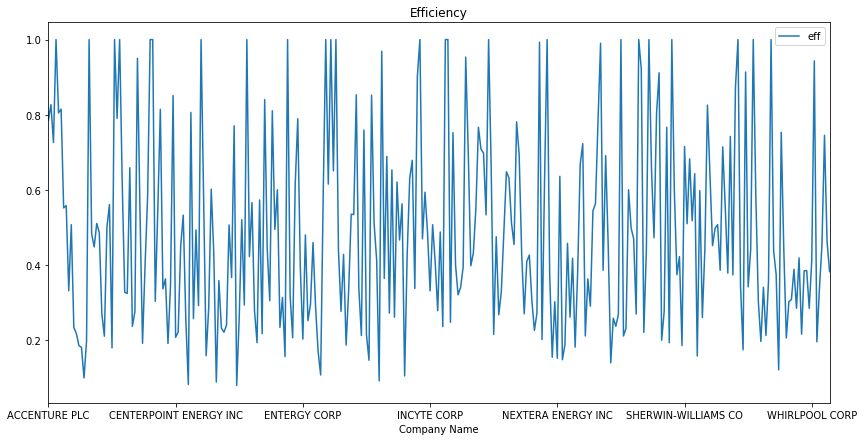

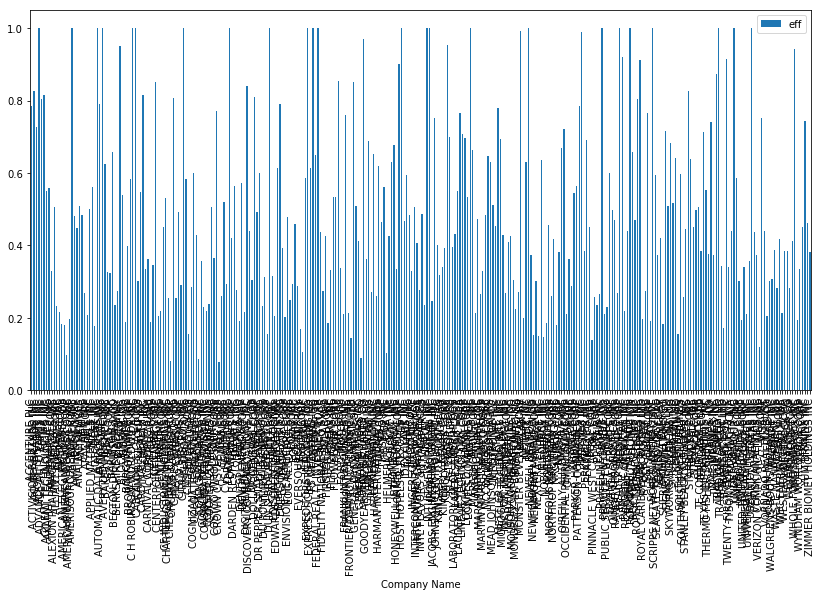

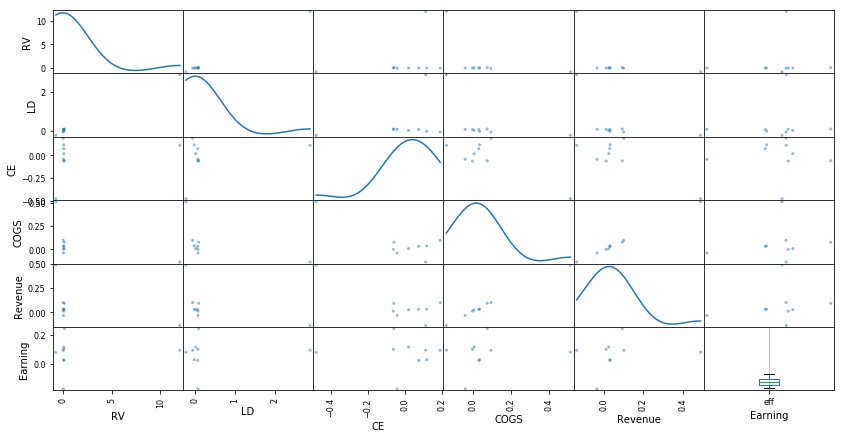

In [10]:
fsize=(14,7)
#scatter plot 
efficiency.plot(title='Efficiency',figsize=fsize)
#bar chart
efficiency.plot.bar(figsize=fsize)
#scatter plot
pd.plotting.scatter_matrix(r,diagonal='kde',figsize=fsize)
#box-plot
efficiency.boxplot()

#statistics of the results
def db(v):print(v,' =\n', repr(eval(v)), '\n')
mean = efficiency.mean(); db('mean')
gmean = pow((efficiency+1).cumprod().iloc[-1],1.0/(T-1))-1; db('gmean')
std = efficiency.std();db('std')
corr = efficiency.corr();db('corr')